>Igor Sorochan DSU-31

# Кластеризация. Домашнее задание

### Данные

В предложенных файлах информация с публичных слушаний Москвы по правилам землепользования и застройки (ПЗЗ). В них комментарии жителей города были застенагрофированы, проклассифицированы (за/против) и нанесены на карту. Данные предоставлены в 2 вариантах, для задания можно использовать любой:
* geo_comment.xlsx
    * **comment** - комментарий одного или списка жителей к проект
    * **multiplier** - количество авторов комментария (может быть 1, может быть список)
    * **x, y** - координаты адреса, по которому был дан определённой комментарий
    * **comment_class** - за (1) / против (-1)
* geo.xlsx - те же данные, но без текстов комментариев и по 1 голосу на строку (ранее в 1 строке могло быть **multiplier** > 1 голоса)
    * **x, y** - координаты адреса, по которому был дан определённой комментарий
    * **comment_class** - за (1) / против (-1)
    
### Обязательное задание

* визуально разделить город на районы безотносительно голосов (провести кластеризацию и вывести картинку)
* аналогично исследовать скопления голосов за и против отдельно
* *подобрать оптимальное число кластеров при помощи кода из тетрадки в конце занятия (оптимально)*
* приложить ноутбук

### Дополнительные задания
* найти наиболее активные в голосовании районы *(подсказка: DBSCAN, не плотные районы обозначены одной меткой и закрашены одним цветом, cmap='gray')*
* для тех, кто уже попробовал работу с текстом: выделить основные тематики комментариев жителей, можно использовать всю имеющуюся дополнительную информацию

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly_express as px
import plotly.graph_objects as go
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_score
import openpyxl
from sklearn.preprocessing import StandardScaler
import hdbscan
import folium
from wordcloud import WordCloud
from nltk.tokenize import sent_tokenize   # Tokenize a sentence into a list of sentences
from nltk.tokenize import word_tokenize   # Tokenize a sentence into a list of words
from nltk.corpus import stopwords         # Corpus reader for stopwords
from collections import Counter

In [2]:
!cd ../.. && ls

GIT cheat sheet.png Well_tory           ipynb PC
Mac                 data                ipynb arch


In [3]:
data_comments = pd.read_excel('../../data/geo_comment.xlsx', index_col='Unnamed: 0')
data_comments.head()

,x,y,comment_class,multiplier,comment
0,37.612416,55.777454,-1,1,Во все разделы правил землепользования и застр...
1,37.612416,55.777454,-1,1,На основании вступившего в законную силу судеб...
2,37.603298,55.742108,-1,1,Внести в Проект правил землепользования и заст...
3,37.558526,55.728758,-1,1,Учитывая социальную значимость проекта строите...
4,37.566431,55.731794,-1,1,Учитывая социальную значимость проекта строите...


We have a significant classes imbalance. 

In [4]:
data_comments.comment_class.value_counts()

comment_class
-1    58552
 1    11830
Name: count, dtype: int64

In [5]:
data_comments.info()

<class 'pandas.core.frame.DataFrame'>
Index: 70382 entries, 0 to 70381
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   x              70382 non-null  float64
 1   y              70382 non-null  float64
 2   comment_class  70382 non-null  int64  
 3   multiplier     70382 non-null  int64  
 4   comment        70382 non-null  object 
dtypes: float64(2), int64(2), object(1)
memory usage: 3.2+ MB


In [6]:
# data = pd.read_excel('../../data/geo.xlsx', index_col='Unnamed: 0')
# data.head()

In [7]:
# data.info()

### Basic cleaning

In [8]:
data_comments.isna().sum()

x                0
y                0
comment_class    0
multiplier       0
comment          0
dtype: int64

In [9]:
data_comments.shape[0]- data_comments.duplicated().sum()

11699

We can assume that there are duplicates becasue of the same coordinates of apartment houses and the same comment_class.  
Let's leave as it is.


In [10]:
X= data_comments[['x', 'y']]
X.head()
st_scaler = StandardScaler()
X_st = st_scaler.fit_transform(X)
X_st 

array([[ 0.17363392, -0.12923628],
       [ 0.17363392, -0.12923628],
       [ 0.10766492, -0.66296372],
       ...,
       [-1.21078898,  0.94742964],
       [-1.01223806,  0.10649107],
       [-0.99241408,  0.76417507]])

The city of Moscoe is divided into 12 administrative okrugs,  
which in turn are subdivided into 146 administrative units,  
which include 125 administrative districts and  
21 administrative settlements.

In [11]:
%%time
for cl_size in range(100, 701, 200):
    clusterer = hdbscan.HDBSCAN(min_cluster_size=cl_size)
    clusterer.fit(X_st)

    fig = px.scatter(X_st, x=X_st[:,0], y=X_st[:,1], color=clusterer.labels_, width=800, height=500)
    fig.update_layout(title=f'min_cluster_size= {cl_size}, number of clusters= {len(np.unique(clusterer.labels_))}', coloraxis_showscale=False)
    fig.update_traces(marker_size=3)
    fig.show()


CPU times: user 12.3 s, sys: 10.3 s, total: 22.6 s
Wall time: 36.7 s


* Tune hyperparameters
* Use silhouette metrics 
* try distance based algorithms

The goal - clusterization by districts (30-50), by voting

use folium to plot data on map

In [12]:
k_inertia = []
clusters_range = range(1,61)

for k in clusters_range:
    kmeans_clusterer = KMeans(n_clusters=21, n_init= 'auto')
    kmeans_clusterer.fit_predict(X)
    # inertia_ —
    # Sum of squared distances of samples to their closest cluster center, weighted by the sample weights if provided.
    k_inertia.append(kmeans_clusterer.inertia_)

fig = px.line(x=clusters_range, y=k_inertia, width=800, height=500, markers=True,
              title='The Elbow Method showing the optimal k')
fig.update_traces(marker_size=7, marker_color='red')
fig.update_xaxes(title_text='number of clusters')
fig.update_yaxes(title_text='inertia')
fig.show()


We may notice minima inertia values w.r.t. number of clusters.

In [13]:
clusters_range = [10, 21, 25]

for k in clusters_range:
    
    kmeans_clusterer = KMeans(n_clusters= k, n_init= 'auto')
    kmeans_clusterer.fit_predict(X)    
 
    centroids = list(kmeans_clusterer.cluster_centers_)
    fig = go.Figure()
    fig.add_trace(go.Scatter(x= X.x, y= X.y, mode= 'markers', name=f'',
                  marker=dict(color=kmeans_clusterer.labels_, size=3)))
    fig.add_trace(go.Scatter(x= [x[0] for x in centroids], y= [x[1] for x in centroids], mode= 'markers', 
                             marker=dict(color="Red", size=15), name=f'Centriods'))

    fig.update_layout(title=f'Number of clusters= {k}',  height=800, width=1000)
    fig.show()

These results are depends only on distances and so they have no correlation with the real administrative districts in the city.

## Let's plot data w.r.t. to comment_class

In [14]:
X2 = data_comments[['x', 'y', 'comment_class']]

In [15]:
data_yes = X2[X2.comment_class == 1]
data_no = X2[X2.comment_class == -1]

In [16]:
clusters_range = [25]

for k in clusters_range:
    fig = go.Figure()  
    # plot yes
    kmeans_clusterer = KMeans(n_clusters= k, n_init= 'auto')
    kmeans_clusterer.fit_predict(data_yes)    
    centroids_yes = list(kmeans_clusterer.cluster_centers_)

    fig.add_trace(go.Scatter(x= data_yes.x, y= data_yes.y, mode= 'markers', name=f'Yes',
                  marker=dict(color="Orange", size=3)))                                         # plot all Yes data
    fig.add_trace(go.Scatter(x= [x[0] for x in centroids_yes], y= [x[1] for x in centroids_yes], mode= 'markers', 
                             marker=dict(color="Red", size=10), name=f'Centriods Yes'))         # plot Yes centroids
    
    # plot no
    kmeans_clusterer = KMeans(n_clusters= k, n_init= 'auto')
    kmeans_clusterer.fit_predict(data_no)    
    centroids_no = list(kmeans_clusterer.cluster_centers_)

    fig.add_trace(go.Scatter(x= data_no.x, y= data_no.y, mode= 'markers', name=f'No',
                  marker=dict(color="Gray", size=3)))                                           # plot all No data
    fig.add_trace(go.Scatter(x= [x[0] for x in centroids_no], y= [x[1] for x in centroids_no], mode= 'markers', 
                             marker=dict(color="Black", size=10), name=f'Centriods No'))        # plot No centroids


    fig.update_xaxes(title_text='Longitude')
    fig.update_yaxes(title_text='Latitude')
    fig.update_layout(title=f'Number of clusters= {k}',  height=800, width=1200)
    fig.show()

### Plot data w.r.t comment_class on map with `folium`

In [17]:
my_map = folium.Map(prefer_canvas=True)

for elem  in centroids_yes:
    marker = folium.Marker(location=[elem[1], elem[0]], popup="Yes",icon=folium.Icon(color='red',icon_color='red'))
    marker.icon = folium.Icon(color='green')
    marker.add_to(my_map)

for elem  in centroids_no:
    folium.Marker(location=[elem[1], elem[0]],  popup='No',icon=folium.Icon(color='blue',icon_color='gray')).add_to(my_map)
    

my_map.fit_bounds(my_map.get_bounds())

my_map

### Plot data on map with `plotly.scatter_mapbox`

In [18]:
# clusterization of comments
X_comm = data_comments[['x', 'y', 'comment_class']]
n_clusters =50
kmeans_clusterer = KMeans(n_clusters= n_clusters, n_init= 'auto', random_state=0)
kmeans_clusterer.fit_predict(X_comm)    
centroids = kmeans_clusterer.cluster_centers_

# form a dataframe for plotting
temp = pd.DataFrame(centroids, columns=['x', 'y', 'comment_class'])
temp.comment_class = temp.comment_class.apply(lambda x: 'Yes' if x > 0 else 'No')

# plot
fig = px.scatter_mapbox(temp, lat='y', lon='x', opacity=0.4, hover_name='comment_class',
                        color='comment_class',
                        width=1400, height=1000, 
                        zoom=9, 
                        size=[20 for x in centroids],
                        mapbox_style='open-street-map',
                        color_discrete_map={'Yes':"red",'No':"blue"}
                        )
# fig.update_geos(fitbounds="locations")   # zoom to locations
fig.update_layout(title=f'Centroids of clusters w.r.t of comment_class (number of clusters= {n_clusters})',  
                  legend_title_text='Comment class', legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
                  # coloraxis_showscale=False
                  )
fig.show()
# fig.show(renderer="browser")  # to open in browser

### What are the most active vote districts?

найти наиболее активные в голосовании районы *(подсказка: DBSCAN, не плотные районы обозначены одной меткой и закрашены одним цветом, cmap='gray')*

In [19]:
# np.unique(clusterer.labels_, return_counts=True)  # to check the number of elements in each cluster

In [30]:
X = data_comments[['x', 'y']]
min_cluster_size =100
clusterer = hdbscan.HDBSCAN(
    min_cluster_size = min_cluster_size,  # set it to the smallest size grouping that you wish to consider a cluster
    min_samples= 50                       # The larger the value of min_samples you provide, the more conservative the clustering – more points will be declared as noise
    )
clusterer.fit(X)
n_clusters_ = clusterer.labels_.max() + 1 # number of clusters (zero base indexing) (ignoring noise (== -1) if present)

threshold = pd.Series(clusterer.outlier_scores_).quantile(0.9)
outliers = np.where(clusterer.outlier_scores_ <= threshold)[0]
normal = np.where(clusterer.outlier_scores_ > threshold)[0]
n_clusters_

/Users/velo1/SynologyDrive/GIT_syno/Mac/Netology/.venv/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1379: RuntimeWarning:

invalid value encountered in double_scalars



101

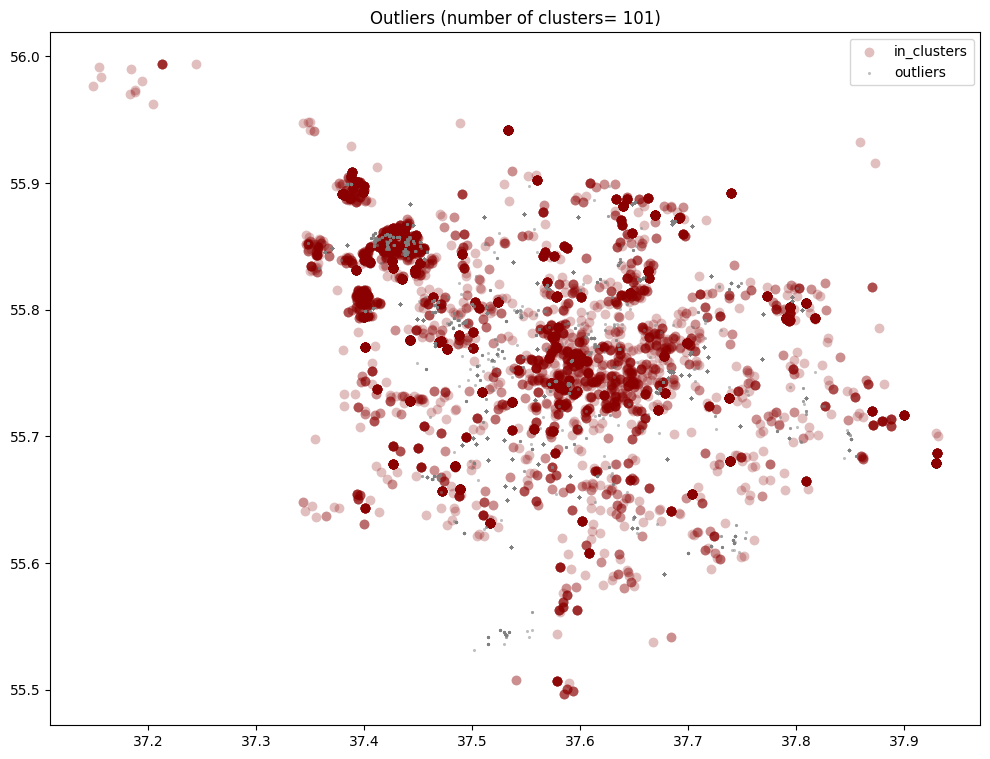

In [31]:
plt.figure(1, figsize=(12,9))
plt.scatter(x=X.loc[normal,'x'], y=X.loc[normal,'y'], s=50, linewidth=0, c='darkred', alpha=0.25, label='in_clusters')
plt.scatter(x=X.loc[outliers,'x'], y=X.loc[outliers,'y'], s=5, linewidth=0, c='gray', alpha=0.5, label='outliers')
plt.title(f'Outliers (number of clusters= {n_clusters_})')
plt.legend()
plt.show()


In [33]:
fig= go.Figure()
fig.add_trace(go.Scattermapbox(
        lon=X.loc[outliers,'x'],lat=X.loc[outliers,'y'],
        mode='markers',name='outliers',
        marker=go.scattermapbox.Marker( color="Blue", size=10, opacity=0.2 ),
    ))

fig.add_trace(go.Scattermapbox(
        lon=X.loc[normal,'x'], lat=X.loc[normal,'y'],
        mode='markers', name='in_clusters',
        marker=go.scattermapbox.Marker( color="Red", size=10, opacity=0.2),
    ))

fig.update_layout(
    mapbox=dict(
        style='open-street-map',
        bearing=0,
        center=go.layout.mapbox.Center( lat=55.7, lon=37.6),
        pitch=10,
        zoom=10
    ),
    width=1400, height=1000,
    title=f'Outliers (number of clusters= {n_clusters_})'
)
fig.update_xaxes(title_text='Longitude')
fig.update_yaxes(title_text='Latitude')
# fig.update_geos(fitbounds="locations")   # zoom to locations
fig.show()

## What are the most common words in comments?

In [22]:
def common_words(text: str, stop_words: list, max_words=100,) -> list[(str, int)]:
    """Input: text, stop_words, max_words
    Output: list of tuples (word, count)"""
    sentences = sent_tokenize(text)
    tokens = word_tokenize(" ".join(sentences))
    words = set([word.lower() for word in tokens if word not in stop_words and word.isalpha()])

    top_words_list = Counter(words).most_common(max_words)

    return top_words_list

In [23]:
def plot_wordcloud(text: str,  max_font_size=250, figure_size=(14,10), 
                   title = None, title_size=15) -> None:
    '''Plots wordcloud'''
    wordcloud = WordCloud(width=1600, height=1200,  collocations=False, 
                          background_color="white", max_font_size=max_font_size).generate(text)

    # Show
    plt.figure(figsize=figure_size, dpi=100)
    plt.title(title, fontdict={'size': title_size, 'verticalalignment': 'bottom'})
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()    

In [24]:
stop_words_rus = stopwords.words('russian')
# define set of top words among positive comments
n_val_yes = data_comments[data_comments.comment_class == 1].comment_class.value_counts().values[0]  # number of positive comments
n_val_no = data_comments[data_comments.comment_class == -1].comment_class.value_counts().values[0]  # number of negative comments

set_yes = common_words(' '.join(data_comments[data_comments.comment_class == 1].comment), 
                       stop_words=stop_words_rus, max_words=100)    # list of positive comments
set_yes = [x[0] for x in set_yes]                                   # leave only words (without counts)

In [25]:
set_no = common_words(' '.join(data_comments[data_comments.comment_class == -1].comment), 
                       stop_words=stop_words_rus, max_words=100)    # list of negative comments
set_no = [x[0] for x in set_no]                                     # leave only words (without counts)


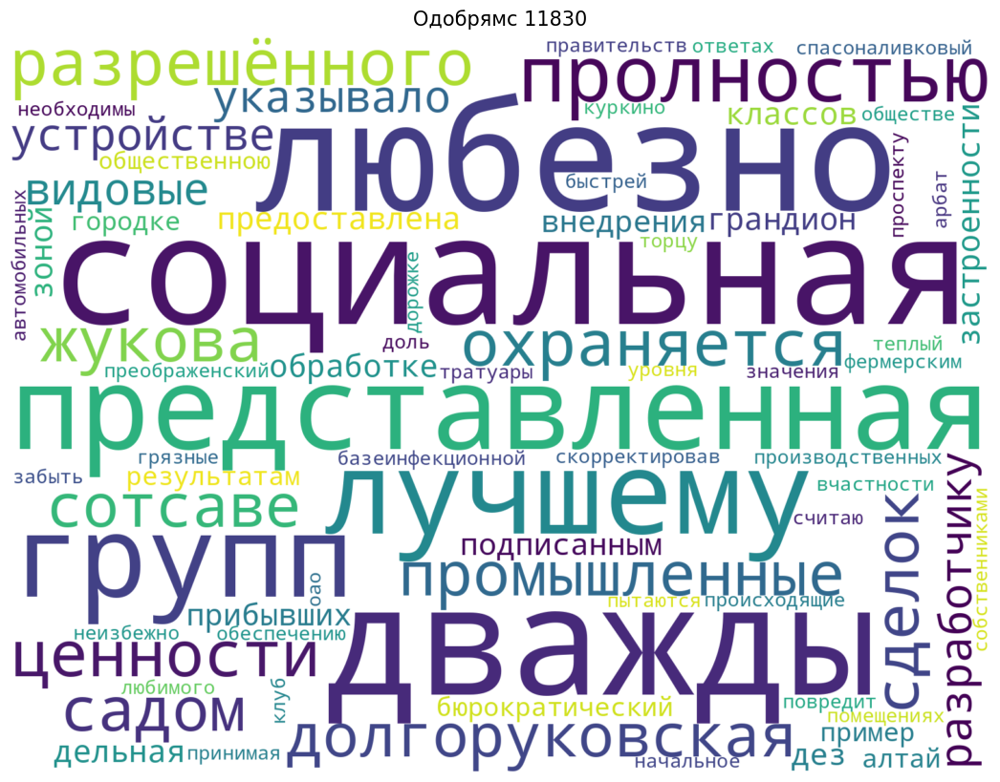

In [26]:

set_1 = set(set_yes) - set(set_no)                        # leave only words that are in positive comments but not in negative
set_2 = set(set_no) - set(set_yes)                        # leave only words that are in negative comments but not in positive
plot_wordcloud(' '.join([word for word in set_1]), title='Одобрямс '+str(n_val_yes))

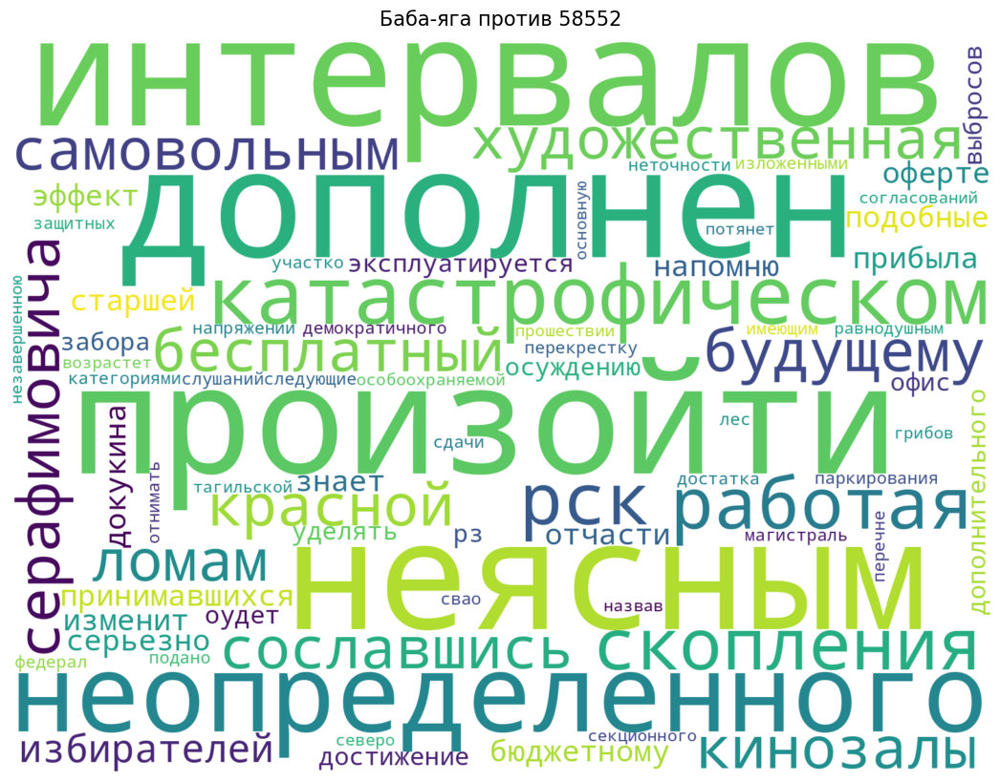

In [27]:
plot_wordcloud(' '.join([word for word in set_2]), title='Баба-яга против '+str(n_val_no))